**Table of contents**<a id='toc0_'></a>    
- [SIPN](#toc1_)    
  - [Relevant abbreviations:](#toc1_1_)    
  - [Training model](#toc1_2_)    
  - [Imports](#toc1_3_)    
  - [Inputs](#toc1_4_)    
- [Download Masks](#toc2_)    
- [North](#toc3_)    
    - [Sea Ice Extent](#toc3_1_1_)    
    - [Ice-Free Dates 15% (IFD15)](#toc3_1_2_)    
  - [Save file](#toc3_2_)    
- [South](#toc4_)    
    - [ Sea Ice Extent](#toc4_1_1_)    
    - [Save file](#toc4_1_2_)    

<!-- vscode-jupyter-toc-config
	numbering=false
	anchor=true
	flat=false
	minLevel=1
	maxLevel=6
	/vscode-jupyter-toc-config -->
<!-- THIS CELL WILL BE REPLACED ON TOC UPDATE. DO NOT WRITE YOUR TEXT IN THIS CELL -->

# <a id='toc1_'></a>[SIPN](#toc0_)

This is a notebook attempting to generate outputs for [SIPN June forecast](https://www.arcus.org/sipn/sea-ice-outlook/2024/june/call).

Relates to the following issue (private repo), [icenet-governance](https://github.com/icenet-ai/icenet-governance/issues/1).

## <a id='toc1_1_'></a>[Relevant abbreviations:](#toc0_)

* SIC: Sea Ice Concentration
* SIA: Sea Ice Area
* SIE: Sea Ice Extent
* SIP: Sea Ice Probability
    * Fraction of ensemble members in an ensemble forecast with September SIC in excess of 15%.
* IAD: Ice Advance Date
    * For Aug and Sept only.
    * First day of the year in the freeze-up season (i.e., after the summer minimum) at which SIC first increases over:
        * IAD15: First day of year at which SIC increases over 15%.
        * IAD80: First day of year at which SIC increases over 80%.
* IFD: Ice-Free Date
    * IFD15: First day that SIC drops below 15%.
    * IFD80: First day that SIC drops below 90%.

## <a id='toc1_2_'></a>[Training model](#toc0_)

These results utilise the trained model corresponding to **ENVS.bas.exp23**, using **IceNet v0.2.4** (+bugfix), but predicted using **IceNet v0.2.9_dev**

## <a id='toc1_3_'></a>[Imports](#toc0_)

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import datetime as dt
import logging

logging.basicConfig(level=logging.ERROR)

from icenet_sipn import SIPNOutputs
from IPython.display import display, HTML, Image

## <a id='toc1_4_'></a>[Inputs](#toc0_)

This notebook assumes prediction was only completed for a singular date rather than specifying a range of dates for `icenet_predict`.

In [3]:
# Path to prediction files
north_prediction_pipeline_path = "../pipeline"
north_prediction_name = "fc.2024-07-31_north"

south_prediction_pipeline_path = north_prediction_pipeline_path
south_prediction_name = "fc.2024-07-31_south"

# Start date for our forecast
date = [dt.date(*[2024, 7, 31])]

# Reference label used for output paths
output_reference = "BAS_icenet_august_2024"

# Method (options: "mean", "ensemble")
# mean: Compute metrics from IceNet ensemble sea ice concentration prediction mean
# ensemble: Compute metric for each IceNet ensemble member's sea ice concentration prediction
#           then, compute the mean and standard deviation.
method="mean"

# <a id='toc2_'></a>[Download Masks](#toc0_)

In [4]:
!icenet_data_masks north
!icenet_data_masks south

[15-08-24 23:17:38 :INFO    ] - Skipping ./data/masks/north/masks/active_grid_cell_mask_01.npy, already exists
[15-08-24 23:17:38 :INFO    ] - Skipping ./data/masks/north/masks/active_grid_cell_mask_02.npy, already exists
[15-08-24 23:17:38 :INFO    ] - Skipping ./data/masks/north/masks/active_grid_cell_mask_03.npy, already exists
[15-08-24 23:17:38 :INFO    ] - Skipping ./data/masks/north/masks/active_grid_cell_mask_04.npy, already exists
[15-08-24 23:17:38 :INFO    ] - Skipping ./data/masks/north/masks/active_grid_cell_mask_05.npy, already exists
[15-08-24 23:17:38 :INFO    ] - Skipping ./data/masks/north/masks/active_grid_cell_mask_06.npy, already exists
[15-08-24 23:17:38 :INFO    ] - Skipping ./data/masks/north/masks/active_grid_cell_mask_07.npy, already exists
[15-08-24 23:17:38 :INFO    ] - Skipping ./data/masks/north/masks/active_grid_cell_mask_08.npy, already exists
[15-08-24 23:17:38 :INFO    ] - Skipping ./data/masks/north/masks/active_grid_cell_mask_09.npy, already exists
[

# <a id='toc3_'></a>[North](#toc0_)

Load up forecast files (ensemble `*.npy` and ensemble averaged `{forecast}.nc`) from IceNet prediction.

In [5]:
north_prediction = SIPNOutputs(hemisphere="north",
                               prediction_pipeline_path=north_prediction_pipeline_path,
                               prediction_name=north_prediction_name,
                               date=date[0]
                               )

Visualising forecast for sanity.

In [6]:
anim = north_prediction.plot_ensemble_mean()
display(HTML(anim.to_jshtml()))

### <a id='toc3_1_1_'></a>[Sea Ice Extent](#toc0_)

Compute daily sea ice extent over 93 day period from forecast initialisation. The `method` argument determines whether SIE is:
- `method = "mean"`: Computed from pre-computed `SIC` forecast mean.
- `method = "ensemble"`: Computed for each ensemble member `SIC` forecast numpy file, then output its mean and standard deviation.
- `method = "observation"`: Computed from OSI-SAF observations (assuming hindcast, and have downloaded data using icenet/download-toolbox python libraries).

In [7]:
north_prediction.compute_daily_sea_ice_extent(method=method).sea_ice_extent_daily_mean

<xarray.DataArray 'sea_ice_extent_daily_mean' (day: 93)> Size: 744B
array([6.73875 , 6.685   , 6.641875, 6.61375 , 6.584375, 6.56125 ,
       6.533125, 6.505625, 6.45875 , 6.419375, 6.37125 , 6.30125 ,
       6.233125, 6.15875 , 6.078125, 6.02125 , 5.94125 , 5.844375,
       5.749375, 5.6825  , 5.5925  , 5.533125, 5.4475  , 5.375   ,
       5.29625 , 5.21625 , 5.15875 , 5.106875, 5.055625, 5.018125,
       4.973125, 4.888125, 4.865   , 4.833125, 4.81125 , 4.785625,
       4.770625, 4.749375, 4.736875, 4.71875 , 4.69375 , 4.689375,
       4.68875 , 4.683125, 4.69375 , 4.69375 , 4.711875, 4.72125 ,
       4.735   , 4.764375, 4.798125, 4.83375 , 4.863125, 4.895625,
       4.93625 , 4.975   , 5.02625 , 5.07625 , 5.1425  , 5.205   ,
       5.2725  , 5.414375, 5.490625, 5.545625, 5.625625, 5.706875,
       5.795625, 5.88375 , 5.971875, 6.07    , 6.200625, 6.35375 ,
       6.481875, 6.64625 , 6.82625 , 7.01625 , 7.241875, 7.455625,
       7.68875 , 7.925   , 8.175625, 8.39    , 8.549375, 8.646875,
       8.724375, 8.805   , 8.8925  , 8.980625, 9.086875, 9.20625 ,
       9.268125, 9.318125, 9.45625 ])
Coordinates:
  * day      (day) datetime64[ns] 744B 2024-08-01 2024-08-02 ... 2024-11-01
Attributes:
    long_name:  Total Sea-Ice Extent for each day
    units:      10⁶ km²

Compute monthly sea ice extent over the forecast period.

In [8]:
north_prediction.compute_monthly_sea_ice_extent(method=method)

<xarray.DataArray 'sea_ice_extent_monthly_mean' (month: 4)> Size: 32B
array([5.9321371 , 4.8419375 , 7.33497984, 9.45625   ])
Coordinates:
  * month    (month) int64 32B 8 9 10 11
Attributes:
    long_name:  Total Sea-Ice Extent for each day
    units:      10⁶ km²

View the Xarray Dataset folder including monthly sea ice extent as required for SIPN. The added variable is called `sea_ice_extent_monthly_mean`.

In [9]:
north_prediction.get_data()

<xarray.Dataset> Size: 2GB
Dimensions:                      (time: 1, yc: 432, xc: 432, leadtime: 93,
                                  ensemble: 10, month: 4)
Coordinates:
  * time                         (time) datetime64[ns] 8B 2024-07-31
  * leadtime                     (leadtime) int64 744B 1 2 3 4 5 ... 90 91 92 93
    forecast_date                (time, leadtime) datetime64[ns] 744B ...
  * xc                           (xc) float64 3kB -5.388e+03 ... 5.388e+03
  * yc                           (yc) float64 3kB 5.388e+03 ... -5.388e+03
    lat                          (yc, xc) float32 746kB ...
    lon                          (yc, xc) float32 746kB ...
  * month                        (month) int64 32B 8 9 10 11
Dimensions without coordinates: ensemble
Data variables:
    Lambert_Azimuthal_Grid       int32 4B ...
    sic_mean                     (time, yc, xc, leadtime) float32 69MB ...
    sic_stddev                   (time, yc, xc, leadtime) float32 69MB ...
    ensemble_members             (time) int64 8B ...
    sic                          (ensemble, time, yc, xc, leadtime) float64 1GB ...
    sea_ice_extent_monthly_mean  (month) float64 32B 5.932 4.842 7.335 9.456
Attributes: (12/36)
    Conventions:               CF-1.6 ACDD-1.3
    comments:                  
    creator_email:             jambyr@bas.ac.uk
    creator_institution:       British Antarctic Survey
    creator_name:              James Byrne
    creator_url:               www.bas.ac.uk
    ...                        ...
    summary:                   \n            This is an output of sea ice con...
    time_coverage_start:       2024-08-01T00:00:00
    time_coverage_end:         2024-11-01T00:00:00
    time_coverage_duration:    P1D
    time_coverage_resolution:  P1D
    title:                     Sea Ice Concentration Prediction

### Sea Ice Probability

Daily SIP

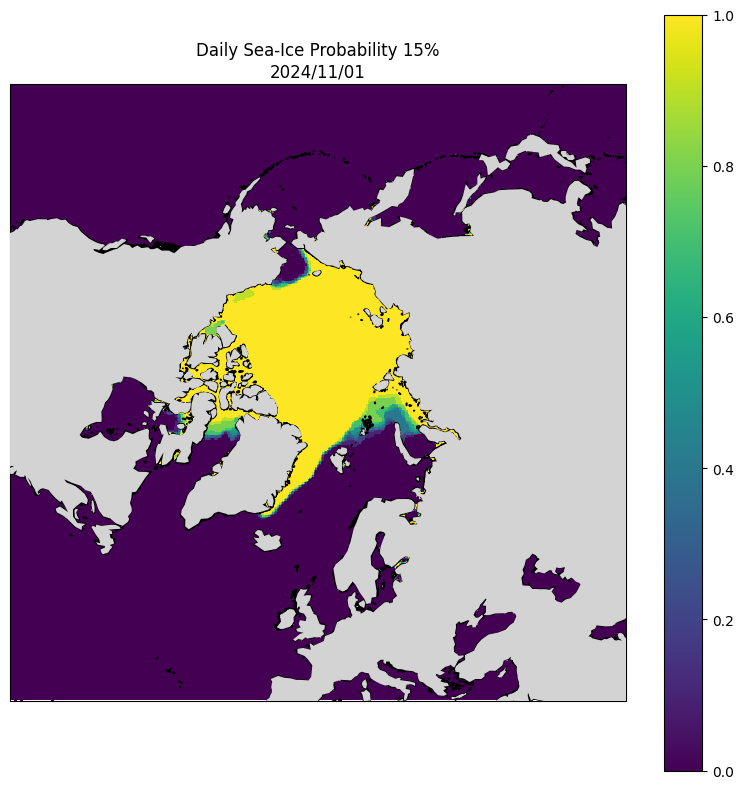

In [10]:
sip = north_prediction.compute_sea_ice_probability(threshold=0.15, aggregate="daily")

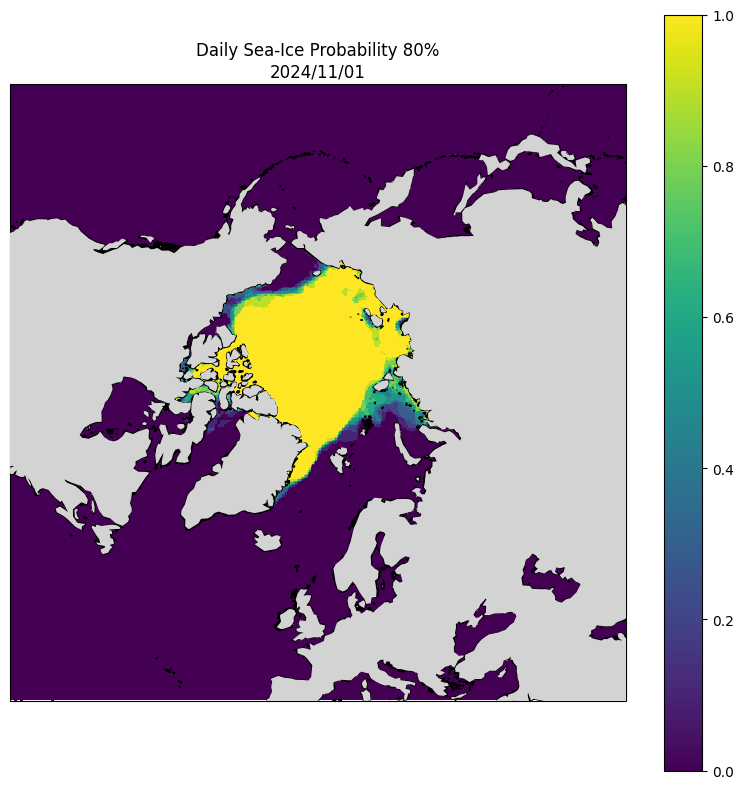

In [11]:
sip = north_prediction.compute_sea_ice_probability(threshold=0.80, aggregate="daily")

Monthly SIP

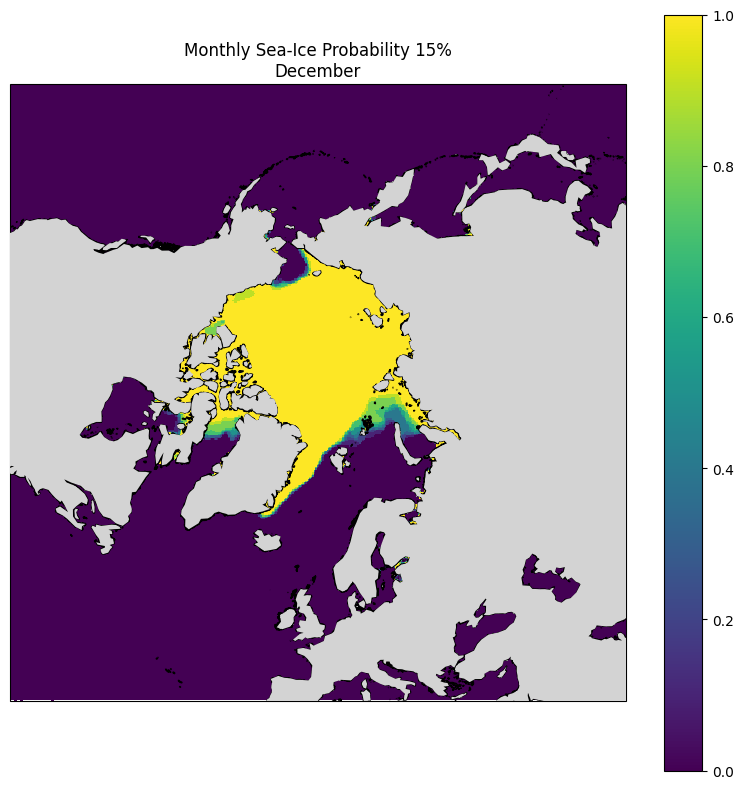

In [12]:
sip = north_prediction.compute_sea_ice_probability(threshold=0.15, aggregate="monthly")

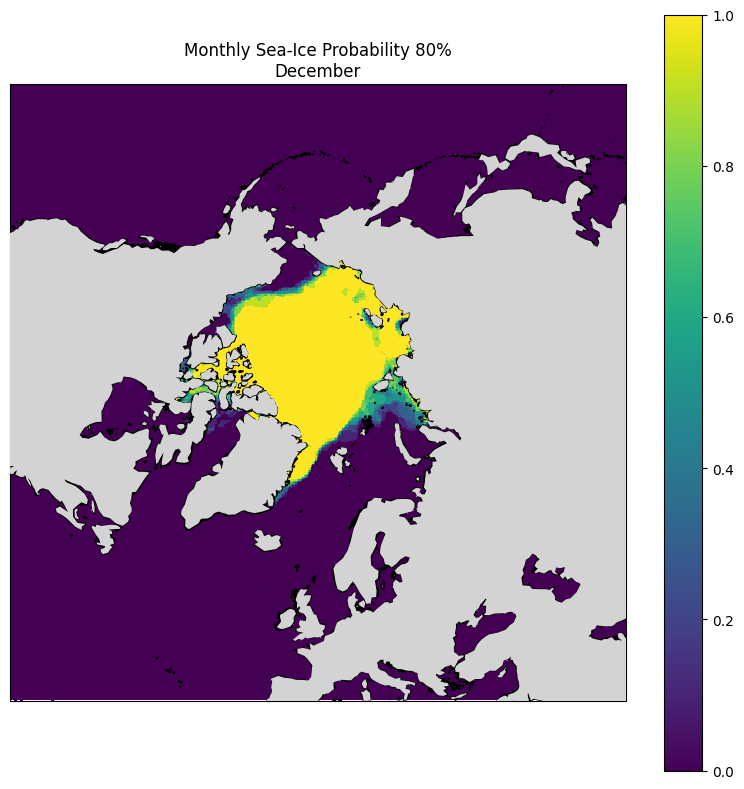

In [13]:
sip = north_prediction.compute_sea_ice_probability(threshold=0.80, aggregate="monthly")

### <a id='toc3_1_2_'></a>[Ice-Free Dates 15% (IFD15)](#toc0_)

Calculate and plot the first day that SIC drops below 15% (Ice-Free Dates 15% 'IFD15').

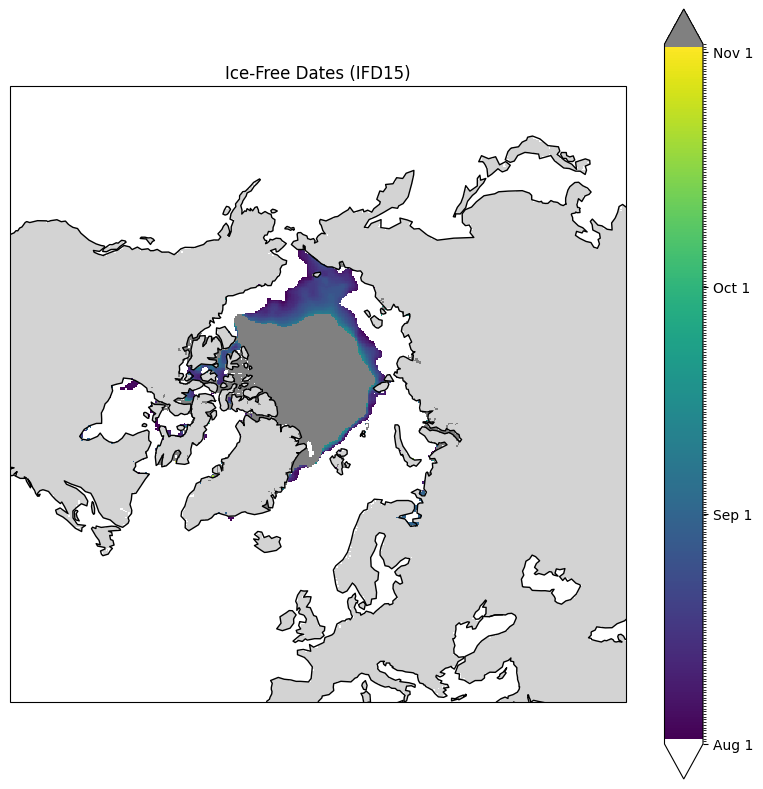

In [14]:
north_prediction.compute_ice_free_dates_from_sic(method=method, threshold=0.15);

### Ice-Free Dates 80% (IFD80)

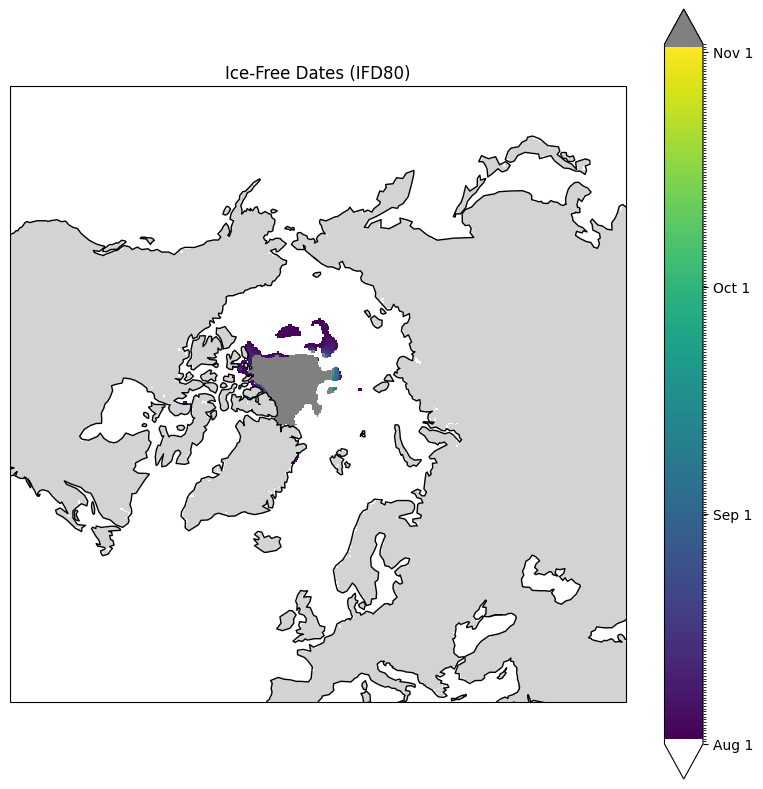

In [15]:
north_prediction.compute_ice_free_dates_from_sic(method=method, threshold=0.80);

## <a id='toc3_2_'></a>[Save file](#toc0_)

Save Xarray Dataset with metrics to netCDF file.

In [16]:
north_prediction.get_data()

<xarray.Dataset> Size: 2GB
Dimensions:                      (time: 1, yc: 432, xc: 432, leadtime: 93,
                                  ensemble: 10, month: 4, day: 93)
Coordinates:
  * time                         (time) datetime64[ns] 8B 2024-07-31
  * leadtime                     (leadtime) int64 744B 1 2 3 4 5 ... 90 91 92 93
    forecast_date                (time, leadtime) datetime64[ns] 744B ...
  * xc                           (xc) float64 3kB -5.388e+03 ... 5.388e+03
  * yc                           (yc) float64 3kB 5.388e+03 ... -5.388e+03
    lat                          (yc, xc) float32 746kB 16.62 16.82 ... 16.62
    lon                          (yc, xc) float32 746kB -135.0 -135.1 ... 45.0
  * month                        (month) int64 32B 8 9 10 11
  * day                          (day) datetime64[ns] 744B 2024-08-01 ... 202...
Dimensions without coordinates: ensemble
Data variables:
    Lambert_Azimuthal_Grid       int32 4B ...
    sic_mean                     (time, yc, xc, leadtime) float32 69MB ...
    sic_stddev                   (time, yc, xc, leadtime) float32 69MB ...
    ensemble_members             (time) int64 8B ...
    sic                          (ensemble, time, yc, xc, leadtime) float64 1GB ...
    sea_ice_extent_monthly_mean  (month) float64 32B 5.932 4.842 7.335 9.456
    sea_ice_probability          (yc, xc, month) float64 6MB 0.0 0.0 ... nan nan
    ice_free_dates_15            (yc, xc) float64 1MB 213.0 213.0 ... nan nan
Attributes: (12/36)
    Conventions:               CF-1.6 ACDD-1.3
    comments:                  
    creator_email:             jambyr@bas.ac.uk
    creator_institution:       British Antarctic Survey
    creator_name:              James Byrne
    creator_url:               www.bas.ac.uk
    ...                        ...
    summary:                   \n            This is an output of sea ice con...
    time_coverage_start:       2024-08-01T00:00:00
    time_coverage_end:         2024-11-01T00:00:00
    time_coverage_duration:    P1D
    time_coverage_resolution:  P1D
    title:                     Sea Ice Concentration Prediction

In [17]:
drop_vars = ["sic", "ensemble", "ensemble_members"]
north_prediction.save_data(output_path="outputs",
                           reference=output_reference,
                           drop_vars=drop_vars # Omit ensemble SIC results
                           )
north_prediction.get_data()

<xarray.Dataset> Size: 2GB
Dimensions:                      (time: 1, yc: 432, xc: 432, leadtime: 93,
                                  ensemble: 10, month: 4, day: 93)
Coordinates:
  * time                         (time) datetime64[ns] 8B 2024-07-31
  * leadtime                     (leadtime) int64 744B 1 2 3 4 5 ... 90 91 92 93
    forecast_date                (time, leadtime) datetime64[ns] 744B ...
  * xc                           (xc) float64 3kB -5.388e+03 ... 5.388e+03
  * yc                           (yc) float64 3kB 5.388e+03 ... -5.388e+03
    lat                          (yc, xc) float32 746kB 16.62 16.82 ... 16.62
    lon                          (yc, xc) float32 746kB -135.0 -135.1 ... 45.0
  * month                        (month) int64 32B 8 9 10 11
  * day                          (day) datetime64[ns] 744B 2024-08-01 ... 202...
Dimensions without coordinates: ensemble
Data variables:
    Lambert_Azimuthal_Grid       int32 4B ...
    sic_mean                     (time, yc, xc, leadtime) float32 69MB ...
    sic_stddev                   (time, yc, xc, leadtime) float32 69MB ...
    ensemble_members             (time) int64 8B ...
    sic                          (ensemble, time, yc, xc, leadtime) float64 1GB ...
    sea_ice_extent_monthly_mean  (month) float64 32B 5.932 4.842 7.335 9.456
    sea_ice_probability          (yc, xc, month) float64 6MB 0.0 0.0 ... nan nan
    ice_free_dates_15            (yc, xc) float64 1MB 213.0 213.0 ... nan nan
Attributes: (12/36)
    Conventions:               CF-1.6 ACDD-1.3
    comments:                  
    creator_email:             jambyr@bas.ac.uk
    creator_institution:       British Antarctic Survey
    creator_name:              James Byrne
    creator_url:               www.bas.ac.uk
    ...                        ...
    summary:                   \n            This is an output of sea ice con...
    time_coverage_start:       2024-08-01T00:00:00
    time_coverage_end:         2024-11-01T00:00:00
    time_coverage_duration:    P1D
    time_coverage_resolution:  P1D
    title:                     Sea Ice Concentration Prediction

___

# <a id='toc4_'></a>[South](#toc0_)

The outlooks requested for the Southern hemisphere are limited to only monthly Sea Ice Extent and its uncertainty rather than the full suite of outlooks as per the Northern hemisphere.

Since the code is hemisphere agnostic, explanations for each command are the same as above.

In [18]:
south_prediction = SIPNOutputs(hemisphere="south",
                               prediction_pipeline_path=south_prediction_pipeline_path,
                               prediction_name=south_prediction_name,
                               date=date[0]
                               )

Plot forecast for sanity check.

In [19]:
anim = south_prediction.plot_ensemble_mean()
display(HTML(anim.to_jshtml()))

### <a id='toc4_1_1_'></a>[ Sea Ice Extent](#toc0_)

Compute monthly sea ice extent over the forecast period.

In [20]:
sie_monthly_ds = south_prediction.compute_monthly_sea_ice_extent()
sie_monthly_ds

<xarray.DataArray 'sea_ice_extent_monthly_mean' (month: 4)> Size: 32B
array([17.88756048, 19.46202083, 19.30173387, 18.22      ])
Coordinates:
  * month    (month) int64 32B 8 9 10 11
Attributes:
    long_name:  Total Sea-Ice Extent for each day
    units:      10⁶ km²

### <a id='toc4_1_2_'></a>[Save file](#toc0_)

In [21]:
drop_vars = ["sic", "ensemble", "ensemble_members"]
south_prediction.save_data(output_path="outputs",
                           reference=output_reference,
                           drop_vars=drop_vars # Omit ensemble SIC results from netCDF output
                           )

In [22]:
south_prediction.xarr

<xarray.Dataset> Size: 2GB
Dimensions:                      (time: 1, yc: 432, xc: 432, leadtime: 93,
                                  ensemble: 10, month: 4)
Coordinates:
  * time                         (time) datetime64[ns] 8B 2024-07-31
  * leadtime                     (leadtime) int64 744B 1 2 3 4 5 ... 90 91 92 93
    forecast_date                (time, leadtime) datetime64[ns] 744B ...
  * xc                           (xc) float64 3kB -5.388e+03 ... 5.388e+03
  * yc                           (yc) float64 3kB 5.388e+03 ... -5.388e+03
    lat                          (yc, xc) float32 746kB ...
    lon                          (yc, xc) float32 746kB ...
  * month                        (month) int64 32B 8 9 10 11
Dimensions without coordinates: ensemble
Data variables:
    Lambert_Azimuthal_Grid       int32 4B ...
    sic_mean                     (time, yc, xc, leadtime) float32 69MB ...
    sic_stddev                   (time, yc, xc, leadtime) float32 69MB ...
    ensemble_members             (time) int64 8B ...
    sic                          (ensemble, time, yc, xc, leadtime) float64 1GB ...
    sea_ice_extent_monthly_mean  (month) float64 32B 17.89 19.46 19.3 18.22
Attributes: (12/36)
    Conventions:               CF-1.6 ACDD-1.3
    comments:                  
    creator_email:             jambyr@bas.ac.uk
    creator_institution:       British Antarctic Survey
    creator_name:              James Byrne
    creator_url:               www.bas.ac.uk
    ...                        ...
    summary:                   \n            This is an output of sea ice con...
    time_coverage_start:       2024-08-01T00:00:00
    time_coverage_end:         2024-11-01T00:00:00
    time_coverage_duration:    P1D
    time_coverage_resolution:  P1D
    title:                     Sea Ice Concentration Prediction

___

# SIPN submission requested results:

Pan-Arctic September Sea Ice Extent:

In [23]:
north_prediction.get_data().sea_ice_extent_monthly_mean.sel(month=9)

<xarray.DataArray 'sea_ice_extent_monthly_mean' ()> Size: 8B
array(4.8419375)
Coordinates:
    month    int64 8B 9
Attributes:
    long_name:  Total Sea-Ice Extent for each month, averaged from daily
    units:      10⁶ km²

Pan-Antarctic September Sea Ice Extent:

In [24]:
south_prediction.get_data().sea_ice_extent_monthly_mean.sel(month=9)

<xarray.DataArray 'sea_ice_extent_monthly_mean' ()> Size: 8B
array(19.46202083)
Coordinates:
    month    int64 8B 9
Attributes:
    long_name:  Total Sea-Ice Extent for each month, averaged from daily
    units:      10⁶ km²